# Apple Stock Price Prediction Using LSTM & Reinforcement Learning Argent for Apple Inc.

- This notebook implements a stock price prediction model using LSTMs. It utilizes historical stock price data to train a neural network model and make future price predictions.
- Creates a reinforcement learning agent that takes actions (buy/sell) based on the stock price predictions from the trained RNN/LSTM model.
- Asses the performance of the reinforcement learning agent using financial metrics, such as profit, ROI, or Sharpe ratio, to determine the effectiveness of the trading strategy.

In [ ]:
# Import Required Libraries
import pandas as pd
from matplotlib import pyplot as plt
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout
import tensorflow as tf
from sklearn.metrics import r2_score

## Data Ingestion

We will load historical stock data from a CSV file named `AAPL.csv`.  
The file has 9909 stock data recodes from 12th of December 1980 to 01st of April 2020, including:
- **Date**
- **Open**
- **High**
- **Low**
- **Close**
- **Adj Close**
- **Adj Close**
- **Volumn**

In [5]:
dataset = pd.read_csv('./AAPL.csv')
dataset.head()

,Date,Open,High,Low,Close,Adj Close,Volume
0,1980-12-12,0.513393,0.515625,0.513393,0.513393,0.406782,117258400
1,1980-12-15,0.488839,0.488839,0.486607,0.486607,0.385558,43971200
2,1980-12-16,0.453125,0.453125,0.450893,0.450893,0.357260,26432000
3,1980-12-17,0.462054,0.464286,0.462054,0.462054,0.366103,21610400
4,1980-12-18,0.475446,0.477679,0.475446,0.475446,0.376715,18362400


## Data Preprocessing & Feature Engineering

Steps:
- check the data types and missing values.
- Sort the data by date.
- Use open value for future prediction.

In [6]:
dataset.shape

(9909, 7)

In [7]:
dataset.isna().sum()

Date         0
Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [8]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 9909 entries, 0 to 9908
Data columns (total 7 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Date       9909 non-null   object 
 1   Open       9909 non-null   float64
 2   High       9909 non-null   float64
 3   Low        9909 non-null   float64
 4   Close      9909 non-null   float64
 5   Adj Close  9909 non-null   float64
 6   Volume     9909 non-null   int64  
dtypes: float64(5), int64(1), object(1)
memory usage: 542.0+ KB


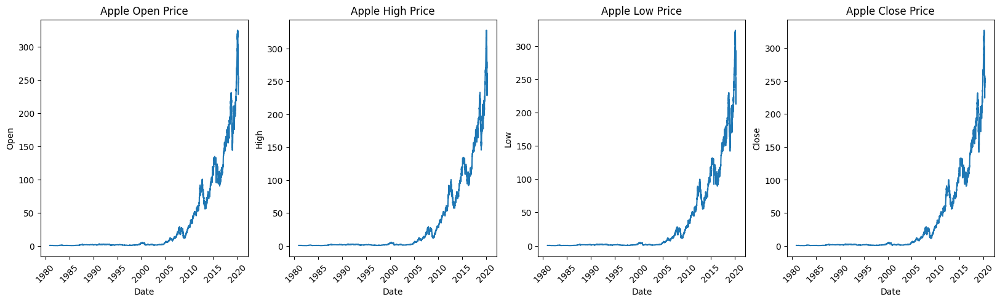

In [9]:
fig, axes = plt.subplots(1, 4, figsize=(20, 5), sharex=True)

columns = ['Open', 'High', 'Low', 'Close']
titles = ['Open Price', 'High Price', 'Low Price', 'Close Price']
dataset['Date'] = pd.to_datetime(dataset['Date'])

# Loop through the columns and plot
for i, col in enumerate(columns):
    axes[i].plot(dataset['Date'], dataset[col])
    axes[i].set_title(f'Apple {titles[i]}')
    axes[i].set_xlabel('Date')
    axes[i].set_ylabel(col)
    axes[i].tick_params(axis='x', rotation=45)

plt.show()

In [10]:
dataset.set_index('Date', inplace=True)

In [11]:
dataset.sort_index(inplace=True)

In [12]:
open_value = dataset.drop(['High', 'Low', 'Close', 'Adj Close', 'Volume'], axis=1)
open_value.head()

,Open
Date,
1980-12-12,0.513393
1980-12-15,0.488839
1980-12-16,0.453125
1980-12-17,0.462054
1980-12-18,0.475446


In [13]:
open_value = open_value.values
open_value

array([[  0.51339287],
       [  0.4888393 ],
       [  0.453125  ],
       ...,
       [250.74000549],
       [255.6000061 ],
       [246.5       ]])

## Data normalization

- Scale the open value data using MinMaxScaler


In [14]:
open_value = open_value.reshape(-1, 1)

scaler = MinMaxScaler(feature_range=(0,1))
scaled_open_value = scaler.fit_transform(open_value)

print(open_value[:5].T)
print(scaled_open_value[:5].T)

[[0.51339287 0.4888393  0.453125   0.46205357 0.47544643]]
[[0.00096978 0.00089412 0.00078407 0.00081158 0.00085285]]


# Creating Training Data & Testing Data (Sliding Window Approach)

- window size = 50
- Split the data to training and testing

In [15]:
data = []
target = []
window_size = 50

for i in range(50, len(scaled_open_value)-window_size):
  data.append(scaled_open_value[i : i + window_size])
  target.append(scaled_open_value[i + window_size])

In [16]:
data_np = np.array(data)
target_np = np.array(target)

print(data_np.shape)
print(target_np.shape)

(9809, 50, 1)
(9809, 1)


In [17]:
train_data = data_np[:9000]
train_target = target_np[:9000]

test_data = data_np[9000:]
test_target = target_np[9000:]

In [18]:
print(train_data.shape)
print(train_target.shape)
print(test_data.shape)
print(test_target.shape)


(9000, 50, 1)
(9000, 1)
(809, 50, 1)
(809, 1)


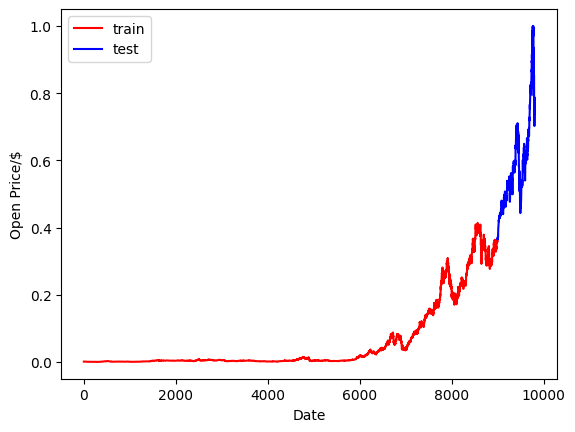

In [19]:
test_x_range = np.arange(9000,9809,1)

plt.plot(train_target, 'r', label='train')
plt.plot(test_x_range, test_target, 'b', label='test')
plt.xlabel('Date')
plt.ylabel('Open Price/$')
plt.legend()
plt.show()

## LSTM Model: Building and Training

We build an LSTM model with:
- Two LSTM layers (with dropout for regularization)
- A Dense output layer  
We then train the model on the training data and validate it on the test set.


In [20]:
model = Sequential()

model.add(LSTM(units=96, return_sequences=True, input_shape=(50,1)))
model.add(Dropout(0.2))

model.add(LSTM(units=40, return_sequences=False))
model.add(Dropout(0.5))

model.add(Dense(units=1, activation='linear'))

model.compile(optimizer='adam', loss='mean_squared_error')


2025-02-24 11:36:53.385389: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M4 Pro
2025-02-24 11:36:53.385430: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 48.00 GB
2025-02-24 11:36:53.385440: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 18.00 GB
2025-02-24 11:36:53.385465: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-02-24 11:36:53.385486: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)
/Users/svhozt/.local/lib/python3.12/site-packages/keras/src/layers/rnn/rnn.py:200: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential m

In [83]:
history = model.fit(train_data, train_target, epochs=50, batch_size=32,  validation_data=(test_data,test_target))

Epoch 1/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 3.1817e-04 - val_loss: 0.0039
Epoch 2/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.8850e-04 - val_loss: 0.0036
Epoch 3/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 12ms/step - loss: 2.9871e-04 - val_loss: 0.0019
Epoch 4/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.9075e-04 - val_loss: 0.0037
Epoch 5/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.9356e-04 - val_loss: 0.0014
Epoch 6/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.8712e-04 - val_loss: 0.0018
Epoch 7/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.6895e-04 - val_loss: 0.0031
Epoch 8/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 3.2638e-04 - val_loss: 0.0033
Epoch 9/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 3.2807e-04 - val_loss: 0.0033
Epoch 10/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.9282e-04 - val_loss: 4.5989e-04
Epoch 11/50
282/282 ━━━━━━━━━━━━━━━━━━━━ 3s 11ms/step - loss: 2.6423e-04 - val_loss: 

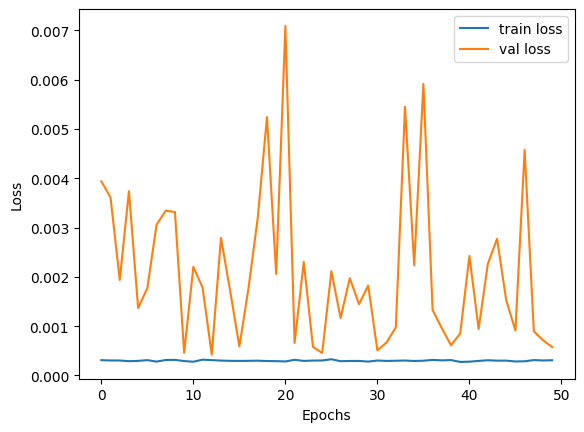

In [84]:
plt.plot(history.history['loss'], label='train loss')
plt.plot(history.history['val_loss'], label='val loss')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.show()

# Generate Predictions using LSTM model

In [85]:
result = model.predict(test_data)
r2 =r2_score(test_target, result)
print(f'R2 Score: {r2}')

26/26 ━━━━━━━━━━━━━━━━━━━━ 0s 4ms/step
R2 Score: 0.9693403989174202


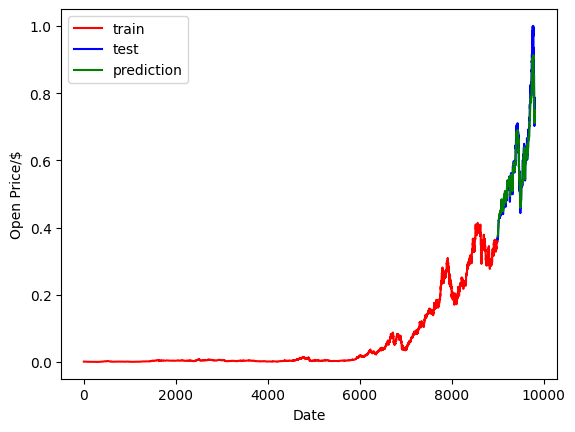

In [90]:
test_x_range = np.arange(9000,9809,1)

plt.plot(train_target, 'r', label='train')
plt.plot(test_x_range, test_target, 'b', label='test')
plt.plot(test_x_range, result, 'g', label='prediction')
plt.xlabel('Date')
plt.ylabel('Open Price/$')
plt.legend()
plt.show()

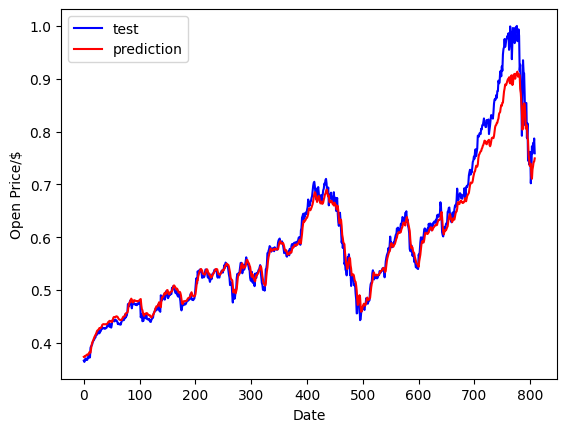

In [91]:
plt.plot(test_target, 'b', label='test')
plt.plot( result, 'r', label='prediction')
plt.xlabel('Date')
plt.ylabel('Open Price/$')
plt.legend()
plt.show()

In [92]:
# Generate predictions for both training and test data
train_pred = model.predict(train_data)

282/282 ━━━━━━━━━━━━━━━━━━━━ 1s 3ms/step


In [93]:
# Calculate R² scores
train_r2 = r2_score(train_target, train_pred)
test_r2 = r2_score(test_target, result)

# Calculate RMSE
from sklearn.metrics import mean_squared_error
train_rmse = np.sqrt(mean_squared_error(train_target, train_pred))
test_rmse = np.sqrt(mean_squared_error(test_target, result))

print(f'Training R²: {train_r2:.4f} | Test R²: {test_r2:.4f}')
print(f'Training RMSE: {train_rmse:.2f} | Test RMSE: {test_rmse:.2f}')

Training R²: 0.9983 | Test R²: 0.9693
Training RMSE: 0.00 | Test RMSE: 0.02


# Save Predictions for RL Agent
- Prepare data for reinforcement learning:

In [95]:
# Create DataFrames with predictions
train_df = pd.DataFrame({
    'Actual': train_target.flatten(),
    'Predicted': train_pred.flatten()
})

test_df = pd.DataFrame({
    'Actual': test_target.flatten(),
    'Predicted': result.flatten()
})

# Save to CSV
train_df.to_csv('lstm_train_predictions.csv', index=False)
test_df.to_csv('lstm_test_predictions.csv', index=False)

In [96]:
from collections import deque
import random
from keras.optimizers import Adam

In [97]:
train_pred_actual = scaler.inverse_transform(train_pred).flatten()
test_pred_actual = scaler.inverse_transform(result).flatten()


In [ ]:
# Create states
def create_states(data, predictions, window=50):
    states = []
    for i in range(len(data)):
        # Current normalized price (last in sequence)
        current_price = data[i][-1][0]  # From windowed data
        
        # Predicted normalized price
        pred_price = predictions[i]
        
        # Create state vector 
        state = np.array([current_price, pred_price])
        states.append(state)
    return np.array(states)

In [99]:
# Create RL states for training and testing
train_states = create_states(train_data, train_pred.flatten())
test_states = create_states(test_data, result.flatten())

In [100]:
# Denormalize prices for reward calculation
train_prices_actual = scaler.inverse_transform(train_target).flatten()
test_prices_actual = scaler.inverse_transform(test_target).flatten()

# Define DQN Agent

- Implements Deep Q-Network (DQN).
- State size: 2 (current price & predicted price).
- Action size: 3 (Buy, Sell, Hold).

In [102]:
class DQNAgent:
    def __init__(self, state_size, action_size):
        self.state_size = state_size
        self.action_size = action_size
        self.memory = deque(maxlen=2000)
        self.gamma = 0.95  # Discount factor
        self.epsilon = 1.0  # Exploration rate
        self.epsilon_min = 0.01
        self.epsilon_decay = 0.995
        self.model = self._build_model()
    
    def _build_model(self):
        model = Sequential()
        model.add(Dense(24, input_dim=self.state_size, activation='relu'))
        model.add(Dense(24, activation='relu'))
        model.add(Dense(self.action_size, activation='linear'))
        model.compile(loss='mse', optimizer=Adam(learning_rate=0.001))
        return model
    
    def remember(self, state, action, reward, next_state, done):
        self.memory.append((state, action, reward, next_state, done))
    
    def act(self, state):
        if np.random.rand() <= self.epsilon:
            return random.randrange(self.action_size)
        act_values = self.model.predict(state, verbose=0)
        return np.argmax(act_values[0])
    
    def replay(self, batch_size):
        minibatch = random.sample(self.memory, batch_size)
        for state, action, reward, next_state, done in minibatch:
            target = reward
            if not done:
                target += self.gamma * np.amax(self.model.predict(next_state, verbose=0)[0])
            target_f = self.model.predict(state, verbose=0)
            target_f[0][action] = target
            self.model.fit(state, target_f, epochs=1, verbose=0)
        if self.epsilon > self.epsilon_min:
            self.epsilon *= self.epsilon_decay

In [103]:
# Initialize agent
state_size = train_states.shape[1]
action_size = 3  # 0=Hold, 1=Buy, 2=Sell
agent = DQNAgent(state_size, action_size)

/Users/svhozt/.local/lib/python3.12/site-packages/keras/src/layers/core/dense.py:87: UserWarning: Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.
  super().__init__(activity_regularizer=activity_regularizer, **kwargs)


# Train RL Agent

- The agent chooses actions based on the state.
- Rewards are given based on whether the trade was profitable.

In [104]:
batch_size = 128  
episodes = 25

# Ensure agent memory has a fixed size
agent.memory = deque(maxlen=10000)

# Precompute price differences to avoid recalculating inside loop
price_differences = np.diff(train_prices_actual)

# Check available devices
print("Available devices:", tf.config.experimental.list_physical_devices())

# Use GPU if available
with tf.device('/GPU:0'):

    for e in range(episodes):
        total_profit = 0
        state = train_states[0].reshape(1, -1)
        print(f"Episode: {e+1}/{episodes}")

        for i in range(1, len(train_states)):
            action = agent.act(state)
            print(f"Action: {action}")
            print(f"State:", i, state)
            print(f"Price:", i, train_prices_actual[i])

            # Fetch current and next price efficiently
            reward = 0
            if action == 1:  # Buy
                reward = price_differences[i - 1]  # Precomputed reward
            elif action == 2:  # Sell
                reward = -price_differences[i - 1]

            total_profit += reward

            next_state = train_states[i].reshape(1, -1)
            done = (i == len(train_states) - 1)

            # Store in memory
            agent.remember(state, action, reward, next_state, done)
            state = next_state

            # Train the model every 10 steps instead of every step
            if i % 100 == 0 and len(agent.memory) > batch_size:
                agent.replay(batch_size)

        print(f"Episode: {e+1}/{episodes}, Total Profit: ${total_profit:.2f}")


Available devices: [PhysicalDevice(name='/physical_device:CPU:0', device_type='CPU'), PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]
Episode: 1/25
Action: 0
State: 1 [[0.000901   0.00196935]]
Price: 1 0.5
Action: 2
State: 2 [[0.00091475 0.00195614]]
Price: 2 0.4910714328289032
Action: 0
State: 3 [[0.00092851 0.00195739]]
Price: 3 0.48883929848670954
Action: 1
State: 4 [[0.000901   0.00195299]]
Price: 4 0.48883929848670954
Action: 0
State: 5 [[0.00089412 0.00194354]]
Price: 5 0.48437500000000006
Action: 2
State: 6 [[0.00089412 0.0019359 ]]
Price: 6 0.4910714328289032
Action: 2
State: 7 [[0.00088036 0.00192723]]
Price: 7 0.5
Action: 0
State: 8 [[0.000901 0.001929]]
Price: 8 0.49330356717109686
Action: 1
State: 9 [[0.00092851 0.00194463]]
Price: 9 0.5066964030265808
Action: 2
State: 10 [[0.00090787 0.00195099]]
Price: 10 0.5357142686843873
Action: 2
State: 11 [[0.00094914 0.00196535]]
Price: 11 0.5602678656578064
Action: 1
State: 12 [[0.00103855 0.00201206]]
Price: 12 0

# Test RL Agent

- Epsilon (0.2): Reduces randomness in decision-making.
- Tracks actions & profits.

In [ ]:
# Disable exploration for testing (0% random actions)
agent.epsilon = 0.2

test_profit = 0.0
actions = []
profits = []

for i in range(len(test_states)):
    # Prepare the state
    state = test_states[i].reshape(1, -1)
    
    # Get agent's action (now purely greedy if epsilon=0)
    action = agent.act(state)

    current_price = test_prices_actual[i]
    next_price = test_prices_actual[i+1] if i < len(test_states) - 1 else current_price
    
    # Calculate profit for each action
    if action == 1:  # Buy
        profit = next_price - current_price
        # OPTIONAL: holding = True; entry_price = current_price
    elif action == 2:  # Sell
        profit = current_price - next_price
        # OPTIONAL: holding = False
    else:  # Hold
        profit = 0
    
    test_profit += profit
    actions.append(action)
    profits.append(profit)

# Print the final results
print("\nTest Results:")
print(f"Total Profit: ${test_profit:.2f}")
print(f"Buy Signals: {actions.count(1)}")
print(f"Sell Signals: {actions.count(2)}")



Test Results:
Total Profit: $151.31
Buy Signals: 700
Sell Signals: 52


# Visualize Trades

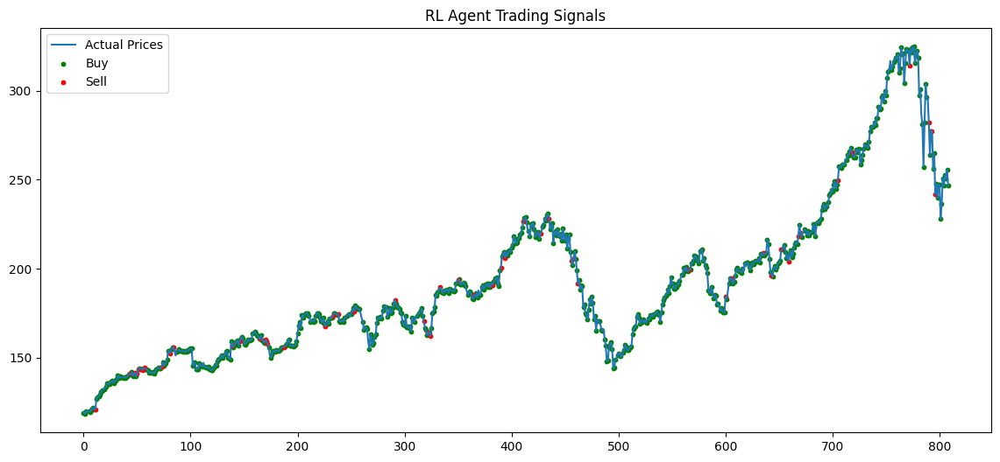

In [108]:
plt.figure(figsize=(14,6))
plt.plot(test_prices_actual, label='Actual Prices')
plt.scatter(np.where(np.array(actions)==1), 
            test_prices_actual[np.array(actions)==1], 
            color='green', label='Buy', marker='o', s=10)
plt.scatter(np.where(np.array(actions)==2), 
            test_prices_actual[np.array(actions)==2], 
            color='red', label='Sell', marker='o', s=10)
plt.title('RL Agent Trading Signals')
plt.legend()
plt.show()

# Financial Performance Assessment

- ROI: Measures return on investment.
- Sharpe Ratio: Measures risk-adjusted return.

In [109]:
# 1. Total Profit
total_profit = np.sum(profits)

# 2. Return on Investment (ROI)
initial_capital = 10000  # Assume starting with $10,000
shares_bought = initial_capital / test_prices_actual[0]  # Shares bought initially
portfolio_value = [initial_capital]

# Simulate portfolio growth based on actions
for i, (action, profit) in enumerate(zip(actions, profits)):
    if i < len(test_prices_actual) - 1:
        if action == 1:  # Buy
            shares = portfolio_value[-1] / test_prices_actual[i]
            portfolio_value.append(shares * test_prices_actual[i+1])
        elif action == 2:  # Sell (short)
            shares = portfolio_value[-1] / test_prices_actual[i]
            portfolio_value.append(shares * (2 * test_prices_actual[i] - test_prices_actual[i+1]))
        else:  # Hold
            portfolio_value.append(portfolio_value[-1])
    else:
        portfolio_value.append(portfolio_value[-1])

roi = ((portfolio_value[-1] - initial_capital) / initial_capital) * 100

# 3. Sharpe Ratio
returns = np.diff(portfolio_value) / portfolio_value[:-1]  # Daily returns
sharpe_ratio = np.mean(returns) / np.std(returns) * np.sqrt(252)  # Annualized

# 4. Maximum Drawdown
cumulative_returns = np.cumsum(returns)
peak = np.maximum.accumulate(cumulative_returns)
drawdown = (peak - cumulative_returns)
max_drawdown = np.max(drawdown)

# 5. Win Rate and Profit Factor
positive_trades = [profit for profit in profits if profit > 0]
negative_trades = [profit for profit in profits if profit < 0]
win_rate = len(positive_trades) / len(profits) * 100
profit_factor = np.sum(positive_trades) / np.abs(np.sum(negative_trades)) if len(negative_trades) > 0 else np.inf

# 6. Number of Trades
num_trades = len(profits)
avg_profit_per_trade = total_profit / num_trades if num_trades > 0 else 0

# Print Results
print("\nPerformance Metrics:")
print(f"1. Total Profit: ${total_profit:.2f}")
print(f"2. ROI: {roi:.2f}%")
print(f"3. Sharpe Ratio: {sharpe_ratio:.2f}")
print(f"4. Max Drawdown: {max_drawdown:.2f}")
print(f"5. Win Rate: {win_rate:.2f}%")
print(f"6. Profit Factor: {profit_factor:.2f}")
print(f"7. Trades Executed: {num_trades}")
print(f"8. Avg Profit/Trade: ${avg_profit_per_trade:.2f}")


Performance Metrics:
1. Total Profit: $151.31
2. ROI: 106.71%
3. Sharpe Ratio: 0.96
4. Max Drawdown: 0.40
5. Win Rate: 52.29%
6. Profit Factor: 1.18
7. Trades Executed: 809
8. Avg Profit/Trade: $0.19


# Visualizations

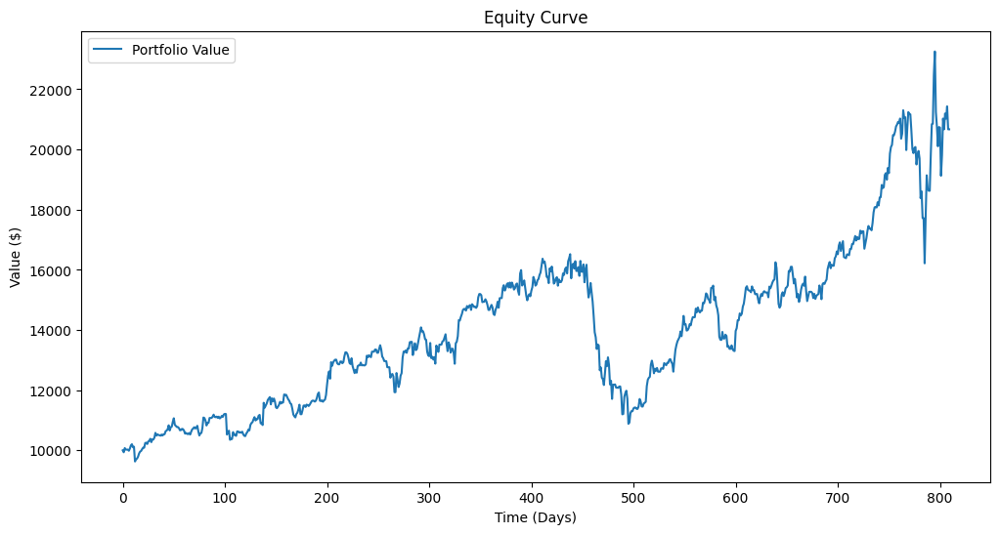

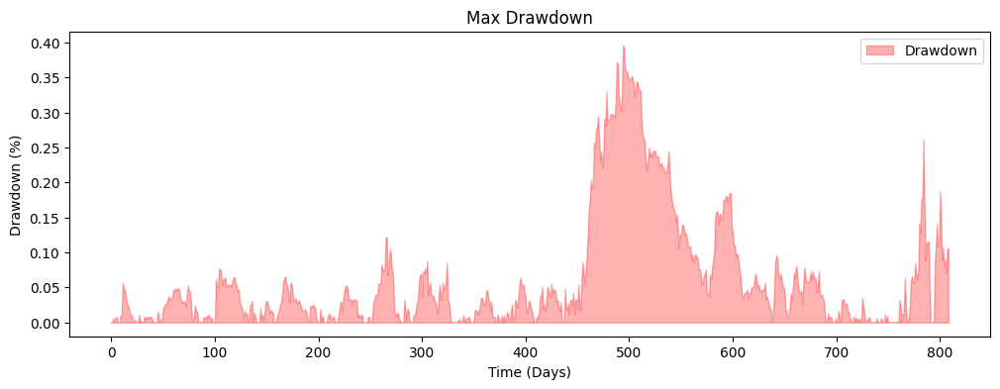

In [110]:
# 1. Equity Curve
plt.figure(figsize=(12, 6))
plt.plot(portfolio_value, label='Portfolio Value')
plt.title("Equity Curve")
plt.xlabel("Time (Days)")
plt.ylabel("Value ($)")
plt.legend()
plt.show()

# Calculate drawdown
cumulative_returns = np.cumsum(np.diff(portfolio_value) / portfolio_value[:-1])
peak = np.maximum.accumulate(cumulative_returns)
drawdown = (peak - cumulative_returns)

# 2. Drawdown Curve
plt.figure(figsize=(12, 4))
plt.fill_between(range(len(drawdown)), drawdown, label='Drawdown', color='red', alpha=0.3)
plt.title("Max Drawdown")
plt.xlabel("Time (Days)")
plt.ylabel("Drawdown (%)")
plt.legend()
plt.show()